In [2]:
#An example YAML file
!cat /home/sara.pieri/Documents/datasets/SeaDroneSee/SeaDroneSee.yaml

train: ../datasets/SeaDroneSee/train/images
val: ../datasets/SeaDroneSee/val/images
#test: ../datasets/SeaDroneSee/test/images

nc: 6
names: ['swimmer', 'floater', 'boat', 'swimmer_on_boat', 'floater_on_boat', 'life_jacket']


In [3]:
import logging
logging.getLogger().setLevel(logging.CRITICAL)
!pip install pylabel > /dev/null

In [4]:
from pylabel import importer

In [6]:
path_to_annotations = "/home/sara.pieri/Documents/datasets/SeaDroneSee/val/labels"

#Identify the path to get from the annotations to the images 
path_to_images = "/home/sara.pieri/Documents/datasets/SeaDroneSee/val/images"

#Import the dataset into the pylable schema 
#Class names are defined here https://github.com/ultralytics/yolov5/blob/master/data/coco128.yaml
yoloclasses =  ['swimmer', 'floater', 'boat', 'swimmer_on_boat', 'floater_on_boat', 'life_jacket']
dataset = importer.ImportYoloV5(path=path_to_annotations, path_to_images=path_to_images, cat_names=yoloclasses,
    img_ext="png")

dataset.df.head(5)

,img_folder,img_filename,img_path,img_id,img_width,img_height,img_depth,ann_segmented,ann_bbox_xmin,ann_bbox_ymin,...,ann_segmentation,ann_iscrowd,ann_pose,ann_truncated,ann_difficult,cat_id,cat_name,cat_supercategory,split,annotated
id,,,,,,,,,,,,,,,,,,,,,
0,/home/sara.pieri/Documents/datasets/SeaDroneSe...,5465.png,NaN,0,3840,2160,3,NaN,538.0,811.5,...,NaN,NaN,NaN,NaN,NaN,2,boat,NaN,NaN,1
1,/home/sara.pieri/Documents/datasets/SeaDroneSe...,5465.png,NaN,0,3840,2160,3,NaN,1177.0,1217.0,...,NaN,NaN,NaN,NaN,NaN,1,floater,NaN,NaN,1
2,/home/sara.pieri/Documents/datasets/SeaDroneSe...,5465.png,NaN,0,3840,2160,3,NaN,608.5,903.0,...,NaN,NaN,NaN,NaN,NaN,3,swimmer_on_boat,NaN,NaN,1
3,/home/sara.pieri/Documents/datasets/SeaDroneSe...,5465.png,NaN,0,3840,2160,3,NaN,1505.0,828.0,...,NaN,NaN,NaN,NaN,NaN,1,floater,NaN,NaN,1
4,/home/sara.pieri/Documents/datasets/SeaDroneSe...,5465.png,NaN,0,3840,2160,3,NaN,1262.5,549.5,...,NaN,NaN,NaN,NaN,NaN,2,boat,NaN,NaN,1


In [7]:
print(f"Number of images: {dataset.analyze.num_images}")
print(f"Number of classes: {dataset.analyze.num_classes}")
print(f"Classes:{dataset.analyze.classes}")
print(f"Class counts:\n{dataset.analyze.class_counts}")

Number of images: 859
Number of classes: 6
Classes:['swimmer', 'floater', 'boat', 'swimmer_on_boat', 'floater_on_boat', 'life_jacket']
Class counts:
boat               2173
floater            1615
swimmer             818
swimmer_on_boat     456
floater_on_boat     405
life_jacket           2
Name: cat_name, dtype: int64


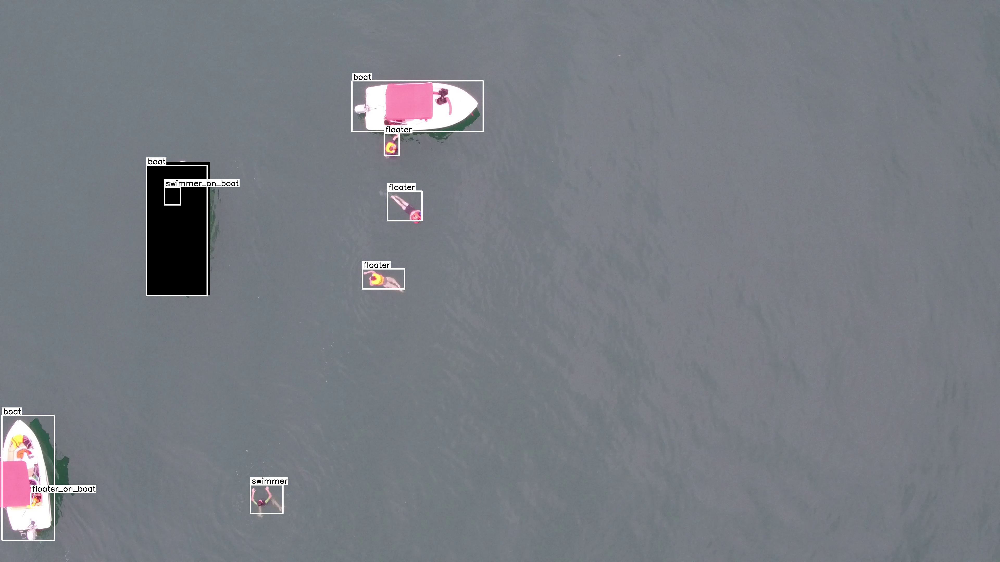

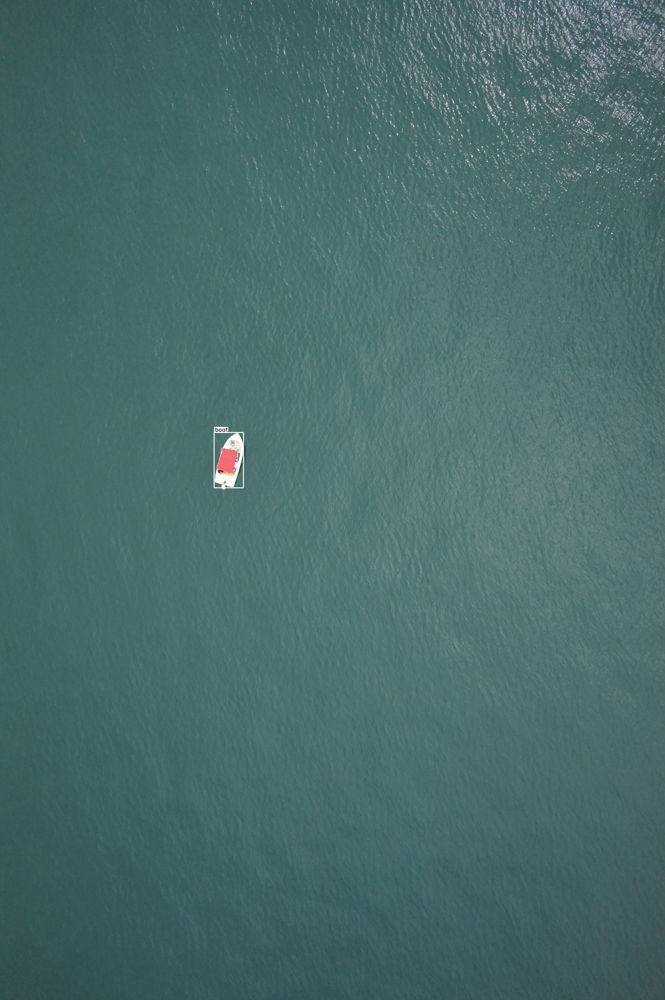

In [8]:
from IPython.display import Image, display
display(dataset.visualize.ShowBoundingBoxes(100))
display(dataset.visualize.ShowBoundingBoxes(30))

In [9]:
dataset.export.ExportToCoco(cat_id_index=1)

['/home/sara.pieri/Documents/datasets/SeaDroneSee/val/labels/dataset.json']